# Tomographic Analysis

In [1]:
import h5py
import os
from pathlib import Path
from datetime import datetime
import matplotlib.patches as patches

sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '../src/')))
from utils.tomo_utils_combined import *

In [2]:
def load_and_analyze_tomogram(tomogram_path, cellinfo_path, pixel_size=20, intensity_threshold=0.8, 
                            rotation_axis='z', rotation_angle=0, fft_threshold=0.0005, 
                            center_cutoff=0.015, voxel_size=(25,25,25), output_dir=None, 
                            save_outputs=True, crop_tomogram=True, crop_size=None, hkl_projection=[1,0,1]):
    """
    Load and analyze tomogram data with FFT analysis and cell info visualization.
    
    Parameters:
    -----------
    tomogram_path : str
        Path to the tomogram TIFF file
    cellinfo_path : str 
        Path to the cellinfo.mat file
    pixel_size : float
        Size of pixels in nm
    intensity_threshold : float
        Threshold for 3D tomogram visualization
    rotation_axis : str
        Axis for rotation ('x', 'y', or 'z')
    rotation_angle : float
        Angle to rotate tomogram in degrees
    fft_threshold : float
        Threshold factor for FFT magnitude
    center_cutoff : float
        Radius for center cutoff in FFT
    voxel_size : tuple
        Size of voxels for analysis (z,y,x)
    output_dir : str, optional
        Base directory for saving outputs. If None, creates one based on tomogram filename
    save_outputs : bool
        Whether to save outputs to disk (default: True)
    
    Returns:
    --------
    dict containing:
        tomo_data : ndarray
            The loaded and processed tomogram data
        magnitude : ndarray
            FFT magnitude data
        voxel_results : dict
            Results of voxel analysis
        cellinfo_data : dict
            Loaded cell information
        figures : dict
            Generated matplotlib and plotly figures:
            - tomogram: 3D tomogram visualization
            - fft: 3D FFT visualization
            - hkl_vector: HKL vector plot
            - unit_cell: Unit cell visualization
            - projection_combined: Combined projection analysis
            - hkl_grid: HKL projection grid
        projections : dict
            Projection data in real and reciprocal space
        output_paths : dict (if save_outputs=True)
            Paths to all saved files including plots, HDF5 file, and summary
        output_dir : str (if save_outputs=True)
            Base directory containing all outputs
    
    Output Directory Structure:
    ---------------------------
    analysis_<tomogram_name>_<timestamp>/
    ├── plots/
    │   ├── 3d_visualizations/
    │   │   ├── tomogram_3d.html (interactive)
    │   │   ├── fft_3d.html (interactive)
    │   │   └── hkl_vector_in_tomogram.html (interactive)
    │   ├── projections/
    │   │   ├── projection_real_space.png
    │   │   ├── projection_real_space_fft.png
    │   │   ├── projection_reciprocal_space.png
    │   │   ├── projection_combined_analysis.png
    │   │   └── hkl_projection_grid.png
    │   └── fft_analysis/
    ├── data/
    │   └── analysis_complete.h5
    ├── unit_cell_info/
    │   └── unit_cell_in_tomogram.html (interactive)
    └── analysis_summary.txt
    """
    
    # Setup output directory structure
    if save_outputs:
        if output_dir is None:
            # Create output directory based on tomogram filename and timestamp
            tomo_name = Path(tomogram_path).stem
            timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
            output_dir = Path(tomogram_path).parent / f"analysis_{tomo_name}_{timestamp}"
        else:
            output_dir = Path(output_dir)
        
        # Create subdirectories
        dirs = {
            'base': output_dir,
            'plots': output_dir / 'plots',
            'plots_3d': output_dir / 'plots' / '3d_visualizations',
            'plots_projections': output_dir / 'plots' / 'projections',
            'plots_fft': output_dir / 'plots' / 'fft_analysis',
            'data': output_dir / 'data',
            'unit_cell': output_dir / 'unit_cell_info',
        }
        
        for dir_path in dirs.values():
            dir_path.mkdir(parents=True, exist_ok=True)
        
        print(f"Output directory created: {output_dir}")
    else:
        dirs = None
    # Load tomogram
    tomo_data = tifffile.imread(tomogram_path)
    
    print(f"Tomogram shape: {tomo_data.shape}")
    print(f"Pixel size: {pixel_size} nm")
    
    # Crop tomogram from the center
    if crop_tomogram:
        shape = tomo_data.shape
        center = np.array(shape) // 2
        start = center - crop_size // 2
        end = start + crop_size
        
        tomo_data = tomo_data[start[0]:end[0], start[1]:end[1], start[2]:end[2]]
        print(f"Tomogram shape after crop: {tomo_data.shape}")
    else:
        print("Tomogram not cropped")
    # Rotate if needed
    if rotation_axis == 'x':
        tomo_data = rotate(tomo_data, rotation_angle, axes=(1, 2), reshape=False)
    elif rotation_axis == 'y':
        tomo_data = rotate(tomo_data, rotation_angle, axes=(0, 2), reshape=False)
    elif rotation_axis == 'z':
        tomo_data = rotate(tomo_data, rotation_angle, axes=(0, 1), reshape=False)
    
    # Create 3D tomogram plot
    fig_tomo = plot_3D_tomogram(tomo_data, intensity_threshold=intensity_threshold)
    
    # Compute FFT
    magnitude, KX, KY, KZ = compute_fft_q(tomo_data, use_vignette=True, pixel_size=pixel_size, scale=1)
    
    # Process FFT data
    threshold = fft_threshold * np.max(magnitude)
    kx_flat = KX.flatten()
    ky_flat = KY.flatten()
    kz_flat = KZ.flatten()
    magnitude_flat = magnitude.flatten()
    
    radial_distance = np.sqrt(kx_flat**2 + ky_flat**2 + kz_flat**2)
    mask = (magnitude_flat > threshold) & (radial_distance > center_cutoff)
    
    kx_filtered = kx_flat[mask]
    ky_filtered = ky_flat[mask]
    kz_filtered = kz_flat[mask]
    magnitude_filtered = magnitude_flat[mask]
    
    # Create FFT plot
    fig_fft = go.Figure(data=go.Scatter3d(
        x=kx_filtered, y=ky_filtered, z=kz_filtered,
        mode='markers',
        marker=dict(size=4, color=magnitude_filtered, colorscale='Viridis', opacity=0.8)
    ))
    
    # Add cutoff sphere visualization
    u = np.linspace(0, 2 * np.pi, 20)
    v = np.linspace(0, np.pi, 20)
    x_sphere = center_cutoff * np.outer(np.cos(u), np.sin(v))
    y_sphere = center_cutoff * np.outer(np.sin(u), np.sin(v))
    z_sphere = center_cutoff * np.outer(np.ones(np.size(u)), np.cos(v))
    
    #fig_fft.add_trace(go.Surface(x=x_sphere, y=y_sphere, z=z_sphere, opacity=0.2))
    fig_fft.update_layout(scene=dict(aspectmode='cube'), width=800, height=800)
    
    # Load cell info and analyze
    cellinfo_data = load_cellinfo_data(cellinfo_path)
    
    # Calculate unit cells info
    limiting_axes = np.min(tomo_data.shape)
    tomo_nm_size = pixel_size * limiting_axes
    n_unit_cells = tomo_nm_size // (cellinfo_data['Vol'][0][0]**(1/3))
    
    print(f'~n unit cells per tomogram: {n_unit_cells}')
    
    # Perform voxel analysis
    voxel_results = analyze_tomogram_voxels(tomo_data, voxel_size=voxel_size)
    print(f"Number of voxels (z, y, x): {voxel_results['n_voxels']}")
    print(f'~m unit cells per voxel: {n_unit_cells*voxel_size[0]/limiting_axes}')
    
    # Generate reciprocal lattice points
    hkl = np.array(list(product([-2, -1, 0, 1, 2], repeat=3)))
    hs, ks, ls = hkl[:, 0], hkl[:, 1], hkl[:, 2]
    
    print("hs:", hs)
    print("ks:", ks)
    print("ls:", ls)
    
    # Calculate reciprocal lattice vectors
    vs = []
    for i, h in enumerate(hs):
        v = (hs[i]*cellinfo_data['recilatticevectors'][0] + 
             ks[i]*cellinfo_data['recilatticevectors'][1] + 
             ls[i]*cellinfo_data['recilatticevectors'][2])
        vs.append(v)
    vs = np.array(vs)
    
    # Add reciprocal lattice points to FFT plot
    fig_fft.add_trace(go.Scatter3d(
        x=vs.T[0], y=vs.T[1], z=vs.T[2],
        mode='markers',
        marker=dict(size=5, color='red', opacity=0.1),
        name='Cell Info'
    ))

    fig_fft.update_layout(
        title="3D FFT Magnitude with Threshold",
        scene=dict(
            xaxis_title="KX",
            yaxis_title="KY", 
            zaxis_title="KZ",
            aspectmode='cube'
        ),
        width=800, height=800
    )

    # Create magnitude threshold mask
    threshold_factor = 1e-3
    magnitude_test = magnitude > threshold_factor*np.max(magnitude)
    

    center = np.array(magnitude.shape) // 2
    R = 48
    x, y, z = np.ogrid[:magnitude.shape[0], :magnitude.shape[1], :magnitude.shape[2]]
    sphere_mask = (x - center[0])**2 + (y - center[1])**2 + (z - center[2])**2 >= R**2
    magnitude_test = magnitude_test & sphere_mask
    
    # Set projection direction
    h, k, l = hkl_projection[0], hkl_projection[1], hkl_projection[2]
    
    # Transpose data to match MATLAB orientation
    tomogram_test = tomo_data.T
    magnitude_test = magnitude_test.T
    
    project_and_plot_along_hkl_2(
        tomogram_test-np.mean(tomogram_test),
        cellinfo_data,
        h, k, l,                        # (h,k,l) or (h,k,i,l) for hex planes; or (u,v,w) for directions
        title_prefix="Test",
        mode="plane",                    # 'plane' → (hkl)/(hkil) normal; 'direction' → [uvw]
        q_vectors=None,                  # for reciprocal-space labeling
        voxel_size=None,                 # (dx, dy, dz) in nm for real-space labeling; if None → pixels
        show_plot=True,
        return_vector=False
    )
        
    # Generate projections
    projection_test, rotated_tomo_test = project_and_plot_along_hkl(
        tomogram_test-np.mean(tomogram_test), cellinfo_data, h, k, l,
        title_prefix="Test", is_reciprocal=False, q_vectors=None, pixel_size=pixel_size
    )
    
    projection_test_reciprocal, rotated_tomo_test_reciprocal = project_and_plot_along_hkl(
        magnitude_test-np.mean(magnitude_test), cellinfo_data, h, k, l,
        title_prefix="Test", is_reciprocal=True, q_vectors=None, pixel_size=pixel_size
    )
    
    # Plot HKL vector and unit cell
    fig_hkl_vector = plot_hkl_vector_in_tomogram(tomogram_test, cellinfo_data, h, k, l,
        is_reciprocal=False, scale=0.1, plot_tomogram=True)
    
    fig_unit_cell = plot_unit_cell_in_tomogram(tomogram_test, cellinfo_data, plot_tomogram=True,
        intensity_threshold=intensity_threshold, pixel_size=pixel_size)
    
    # Plot real space projection and its FFT
    fig_proj_combined, ax = plt.subplots(1, 2, figsize=(20, 10))
    ax[0].imshow(projection_test.T, cmap='gray')
    ax[0].set_title('Real Space Projection')
    ax[0].axis('off')
    
    # Add scale bar (positioned in bottom-left corner with padding)
    scalebar_length_nm = 2000  # Length in nm
    scalebar_length_pixels = scalebar_length_nm / pixel_size
    scalebar_width_pixels = 10  # Fixed width in pixels for better visibility
    scalebar_color = 'white'
    
    # Position scale bar in bottom-left corner with padding
    padding = 30  # Padding from edges in pixels
    scalebar_x_start = padding
    scalebar_y_pos = projection_test.T.shape[0] - padding - scalebar_width_pixels
    
    # Ensure scale bar doesn't go outside image bounds
    if scalebar_x_start + scalebar_length_pixels > projection_test.T.shape[1]:
        scalebar_length_pixels = projection_test.T.shape[1] - scalebar_x_start - 10
        scalebar_length_nm = scalebar_length_pixels * pixel_size
    
    rect = patches.Rectangle(
        (scalebar_x_start, scalebar_y_pos),
        scalebar_length_pixels,
        scalebar_width_pixels,
        facecolor=scalebar_color,
        edgecolor='black',
        linewidth=1
    )
    ax[0].add_patch(rect)
    
    # Add scale bar label (positioned above the scale bar)
    label_y_pos = scalebar_y_pos - 15  # Position label above scale bar
    ax[0].text(
        scalebar_x_start + scalebar_length_pixels/2,
        label_y_pos,
        f'{int(scalebar_length_nm/1000)} μm',
        color=scalebar_color,
        ha='center',
        va='top',
        fontsize=20,
        weight='bold',
        bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.5, edgecolor='white', linewidth=1)
    )
    ax[1].imshow((np.abs(np.fft.fftshift(np.fft.fft2(projection_test.T)))**2),
        cmap='jet', norm=colors.LogNorm())
    ax[1].set_title('FFT of Real Space Projection')
    ax[1].axis('off')
    fig_proj_combined.suptitle(f'Projection Analysis (h={h}, k={k}, l={l})', fontsize=14)
    plt.show()
    
    # Plot HKL projection grid
    fig_grid = plot_hkl_projection_grid(tomo_data.T, magnitude_test.T,
        cellinfo_data, pixel_size=pixel_size)
    
    # Save all outputs if requested
    output_paths = {}
    if save_outputs:
        print("\nSaving outputs...")
        
        # Save Plotly figures (HTML format)
        print("Saving 3D visualizations...")
        fig_tomo_path = dirs['plots_3d'] / 'tomogram_3d.html'
        fig_tomo.write_html(str(fig_tomo_path))
        output_paths['tomogram_3d_html'] = str(fig_tomo_path)
        
        fig_fft_path = dirs['plots_fft'] / 'fft_3d.html'
        fig_fft.write_html(str(fig_fft_path))
        output_paths['fft_3d_html'] = str(fig_fft_path)
        
        # Save projection images
        print("Saving projections...")
        proj_real_path = dirs['plots_projections'] / 'projection_real_space.png'
        plt.figure(figsize=(10, 10))
        plt.imshow(projection_test, cmap='gray')
        plt.title(f'Real Space Projection (h={h}, k={k}, l={l})')
        plt.colorbar()
        plt.savefig(proj_real_path, dpi=300, bbox_inches='tight')
        plt.close()
        output_paths['projection_real'] = str(proj_real_path)
        
        proj_real_fft_path = dirs['plots_projections'] / 'projection_real_space_fft.png'
        plt.figure(figsize=(10, 10))
        plt.imshow(np.abs(np.fft.fftshift(np.fft.fft2(projection_test)))**2,
                   cmap='jet', norm=colors.LogNorm())
        plt.title(f'FFT of Real Space Projection (h={h}, k={k}, l={l})')
        plt.colorbar()
        plt.savefig(proj_real_fft_path, dpi=300, bbox_inches='tight')
        plt.close()
        output_paths['projection_real_fft'] = str(proj_real_fft_path)
        
        proj_reciprocal_path = dirs['plots_projections'] / 'projection_reciprocal_space.png'
        plt.figure(figsize=(10, 10))
        plt.imshow(projection_test_reciprocal, cmap='gray')
        plt.title(f'Reciprocal Space Projection (h={h}, k={k}, l={l})')
        plt.colorbar()
        plt.savefig(proj_reciprocal_path, dpi=300, bbox_inches='tight')
        plt.close()
        output_paths['projection_reciprocal'] = str(proj_reciprocal_path)
        
        # Save combined projection plot
        proj_combined_path = dirs['plots_projections'] / 'projection_combined_analysis.png'
        fig_proj_combined.savefig(proj_combined_path, dpi=300, bbox_inches='tight')
        output_paths['projection_combined'] = str(proj_combined_path)
        
        # Save HKL projection grid (matplotlib figure)
        grid_path = dirs['plots_projections'] / 'hkl_projection_grid.png'
        fig_grid.savefig(grid_path, dpi=300, bbox_inches='tight')
        output_paths['hkl_projection_grid'] = str(grid_path)
        
        # Save HKL vector plot (Plotly figure - save as HTML)
        hkl_vector_path = dirs['plots_3d'] / 'hkl_vector_in_tomogram.html'
        fig_hkl_vector.write_html(str(hkl_vector_path))
        output_paths['hkl_vector_plot'] = str(hkl_vector_path)
        
        # Save unit cell plot (Plotly figure - save as HTML)
        unit_cell_path = dirs['unit_cell'] / 'unit_cell_in_tomogram.html'
        fig_unit_cell.write_html(str(unit_cell_path))
        output_paths['unit_cell_plot'] = str(unit_cell_path)
        
        print(f"Saved {len([k for k in output_paths.keys() if 'plot' in k or 'grid' in k or 'html' in k])} plot files")
        
        # Save HDF5 file with all data
        print("Saving HDF5 file with all data...")
        h5_path = dirs['data'] / 'analysis_complete.h5'
        with h5py.File(h5_path, 'w') as h5f:
            # Create main groups
            grp_tomo = h5f.create_group('tomogram')
            grp_fft = h5f.create_group('fft')
            grp_projections = h5f.create_group('projections')
            grp_voxels = h5f.create_group('voxel_analysis')
            grp_cell = h5f.create_group('cell_info')
            grp_params = h5f.create_group('parameters')
            
            # Save tomogram data
            grp_tomo.create_dataset('data', data=tomo_data, compression='gzip')
            grp_tomo.create_dataset('rotated_real_space', data=rotated_tomo_test, compression='gzip')
            grp_tomo.create_dataset('rotated_reciprocal_space', data=rotated_tomo_test_reciprocal, compression='gzip')
            grp_tomo.attrs['shape'] = tomo_data.shape
            grp_tomo.attrs['pixel_size_nm'] = pixel_size
            
            # Save FFT data
            grp_fft.create_dataset('magnitude', data=magnitude, compression='gzip')
            grp_fft.create_dataset('KX', data=KX, compression='gzip')
            grp_fft.create_dataset('KY', data=KY, compression='gzip')
            grp_fft.create_dataset('KZ', data=KZ, compression='gzip')
            grp_fft.create_dataset('magnitude_mask', data=magnitude_test, compression='gzip')
            grp_fft.attrs['threshold_factor'] = fft_threshold
            grp_fft.attrs['center_cutoff'] = center_cutoff
            
            # Save projection data
            grp_projections.create_dataset('real_space', data=projection_test, compression='gzip')
            grp_projections.create_dataset('reciprocal_space', data=projection_test_reciprocal, compression='gzip')
            grp_projections.attrs['h'] = h
            grp_projections.attrs['k'] = k
            grp_projections.attrs['l'] = l
            
            # Save voxel analysis results
            for key, value in voxel_results.items():
                if isinstance(value, np.ndarray):
                    grp_voxels.create_dataset(key, data=value, compression='gzip')
                elif isinstance(value, (tuple, list)):
                    grp_voxels.attrs[key] = value
                else:
                    grp_voxels.attrs[key] = value
            
            # Save cell info data
            for key, value in cellinfo_data.items():
                if isinstance(value, np.ndarray):
                    grp_cell.create_dataset(key, data=value, compression='gzip')
                else:
                    try:
                        grp_cell.attrs[key] = value
                    except:
                        # Some MATLAB types might not convert directly
                        grp_cell.attrs[key] = str(value)
            
            # Save parameters
            grp_params.attrs['tomogram_path'] = tomogram_path
            grp_params.attrs['cellinfo_path'] = cellinfo_path
            grp_params.attrs['pixel_size'] = pixel_size
            grp_params.attrs['intensity_threshold'] = intensity_threshold
            grp_params.attrs['rotation_axis'] = rotation_axis
            grp_params.attrs['rotation_angle'] = rotation_angle
            grp_params.attrs['fft_threshold'] = fft_threshold
            grp_params.attrs['center_cutoff'] = center_cutoff
            grp_params.attrs['voxel_size'] = voxel_size
            grp_params.attrs['analysis_timestamp'] = datetime.now().isoformat()
            
        output_paths['h5_file'] = str(h5_path)
        
        # Save analysis summary as text file
        print("Saving analysis summary...")
        summary_path = dirs['base'] / 'analysis_summary.txt'
        limiting_axes = np.min(tomo_data.shape)
        tomo_nm_size = pixel_size * limiting_axes
        n_unit_cells = tomo_nm_size // (cellinfo_data['Vol'][0][0]**(1/3))
        m_unit_cells_per_voxel = n_unit_cells * voxel_size[0] / limiting_axes
        
        with open(summary_path, 'w') as f:
            f.write("=" * 80 + "\n")
            f.write("TOMOGRAM ANALYSIS SUMMARY\n")
            f.write("=" * 80 + "\n\n")
            f.write(f"Analysis Date: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}\n\n")
            
            f.write("INPUT FILES:\n")
            f.write(f"  Tomogram: {tomogram_path}\n")
            f.write(f"  Cell Info: {cellinfo_path}\n\n")
            
            f.write("TOMOGRAM PROPERTIES:\n")
            f.write(f"  Shape: {tomo_data.shape}\n")
            f.write(f"  Pixel Size: {pixel_size} nm\n")
            f.write(f"  Rotation: {rotation_angle}° around {rotation_axis}-axis\n")
            f.write(f"  Intensity Threshold: {intensity_threshold}\n\n")
            
            f.write("FFT ANALYSIS:\n")
            f.write(f"  FFT Threshold Factor: {fft_threshold}\n")
            f.write(f"  Center Cutoff Radius: {center_cutoff}\n")
            f.write(f"  Max Magnitude: {np.max(magnitude):.6e}\n\n")
            
            f.write("VOXEL ANALYSIS:\n")
            f.write(f"  Voxel Size: {voxel_size}\n")
            f.write(f"  Number of Voxels (z, y, x): {voxel_results['n_voxels']}\n\n")
            
            f.write("UNIT CELL INFORMATION:\n")
            f.write(f"  ~n unit cells per tomogram: {n_unit_cells:.2f}\n")
            f.write(f"  ~m unit cells per voxel: {m_unit_cells_per_voxel:.2f}\n\n")
            
            f.write("PROJECTION:\n")
            f.write(f"  HKL indices: ({h}, {k}, {l})\n\n")
            
            f.write("OUTPUT FILES:\n")
            for key, path in output_paths.items():
                f.write(f"  {key}: {path}\n")
            f.write("\n" + "=" * 80 + "\n")
        
        output_paths['summary'] = str(summary_path)
        
        print(f"\nAll outputs saved to: {output_dir}")
        print(f"HDF5 file: {h5_path}")
        print(f"Summary file: {summary_path}")
    
    result = {
        'tomo_data': tomo_data,
        'magnitude': magnitude,
        'voxel_results': voxel_results,
        'cellinfo_data': cellinfo_data,
        'figures': {
            'tomogram': fig_tomo,
            'fft': fig_fft,
            'hkl_vector': fig_hkl_vector,
            'unit_cell': fig_unit_cell,
            'projection_combined': fig_proj_combined,
            'hkl_grid': fig_grid
        },
        'projections': {
            'real_space': projection_test,
            'reciprocal_space': projection_test_reciprocal,
            'rotated_tomo_real': rotated_tomo_test,
            'rotated_tomo_reciprocal': rotated_tomo_test_reciprocal
        }
    }
    
    if save_outputs:
        result['output_paths'] = output_paths
        result['output_dir'] = str(output_dir)
    
    return result




In [3]:
"""
USAGE EXAMPLE:
==============

The load_and_analyze_tomogram function now automatically saves all outputs to a 
structured directory hierarchy and an HDF5 file.

Basic Usage:
-----------
"""

# 2025_Feb: ZC9
tomogram_path = "../data/tomograms/tomogram_alignment_recon_56nm.tiff"
#tomogram_path = "../data/tomograms/180_projections_tomogram_alignment_recon_28nm.tiff"
cellinfo_path = "../data/cellinfo/cellinfo_ZCB_9.mat"
zc9_params={
    'pixel_size': 56, #28
    'intensity_threshold': 0.75,
    'fft_threshold': 0.00007,
    'center_cutoff': 0.025,
    'hkl_projection': [1,0,1],
    'crop_size': np.array([384, 372, 506]) 
}

##################################################################
# OTHER EXAMPLES
##################################################################

# # 2025_Feb: ZC4
# tomogram_path="/net/micdata/data2/12IDC/2025_Feb/misc/ZC4_3D_/tomogram_alignment_recon_28nm.tif"
# #tomogram_path="/net/micdata/data2/12IDC/2025_Feb/misc/ZC4_/new_tomogram_alignment_recon_56nm.tiff"
# cellinfo_path = "/home/beams/PTYCHOSAXS/cellinfo_ZC4.mat"
# zc4_params={
#     'pixel_size': 28,
#     'intensity_threshold': 0.75,
#     'fft_threshold': 0.00007,
#     'center_cutoff': 0.025,
#     'hkl_projection': [1,1,-1], #[0,1,0]
#     'crop_size': np.array([300, 280, 300])
# }

# # 2024_Dec: JM01
# #tomogram_path = "/net/micdata/data2/12IDC/2024_Dec/results/analysis_tomo/JM01/tomogram_alignment_recon_FBP_28nm_2.tiff"
# #tomogram_path = "/net/micdata/data2/12IDC/2024_Dec/results/analysis_tomo/JM01/tomogram_alignment_recon_FBP_14nm.tif"
# tomogram_path = "/net/micdata/data2/12IDC/2024_Dec/misc/JM01_3D/Ndp512_MLc_p10_vp4_gInf_Iter400/recons/tomogram_alignment_recon_FBP_14nm.tif"
# #cellinfo_path = "/net/micdata/data2/12IDC/2024_Dec/results/analysis_tomo/JM01/cellinfo_JM01.mat"
# #cellinfo_path = "/net/micdata/data2/12IDC/2024_Dec/misc/JM01_3D/Ndp512_MLc_p10_vp4_gInf_Iter400/recons/jm01_3d.mat"
# cellinfo_path="/home/beams/PTYCHOSAXS/cellinfo_JM01_hex.mat"
# jm01_params={
#     'pixel_size': 14,
#     'intensity_threshold': 0.75,
#     'fft_threshold': 0.00002,
#     'center_cutoff': 0.025,
#     'hkl_projection': [0,0,1,0],
#     'crop_size': np.array([431, 512, 512]) 
# }

# # 2025_Jul: ZC6
# tomogram_path = "/net/micdata/data2/12IDC/2025_Jul/results/analysis_tomo/ZC6_3D/p20nm/tomogram_alignment_recon.tiff"
# cellinfo_path = "/net/micdata/data2/12IDC/2025_Jul/results/analysis_tomo/ZC6_3D/cellinfo.mat"
# zc6_params={
#     'pixel_size': 20,
#     'intensity_threshold': 0.65,
#     'fft_threshold': 0.000002,
#     'center_cutoff': 0.01,
#     'hkl_projection': [0,1,-1],
#     'crop_size': np.array([512, 550, 650]) 
# }

##################################################################
# END OF EXAMPLES
##################################################################





Output directory created: ../example/06_Tomographic_Analysis
Tomogram shape: (195, 251, 253)
Pixel size: 56 nm
Tomogram not cropped
~n unit cells per tomogram: 16.0
Number of voxels (z, y, x): (8, 11, 11)
~m unit cells per voxel: 2.051282051282051
hs: [-2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2 -2
 -2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2]
ks: [-2 -2 -2 -2 -2 -1 -1 -1 -1 -1  0  0  0  0  0  1  1  1  1  1  2  2  2  2
  2 -2 -2 -2 -2 -2 -1 -1 -1 -1 -1  0  0  0  0  0  1  1  1  1  1  2  2  2
  2  2 -2 -2 -2 -2 -2 -1 -1 -1 -1 -1  0  0  0  0  0  1  1  1  1  1  2  2
  2  2  2 -2 -2 -2 -2 -2 -1 -1 -1 -1 -1  0  0  0  0  0  1  1  1  1  1  2
  2  2  2  2 -2 -2 -2 -2 -2 -1 -1 -1 -1 -1  0  0  0  0  0  1  1  1  1 

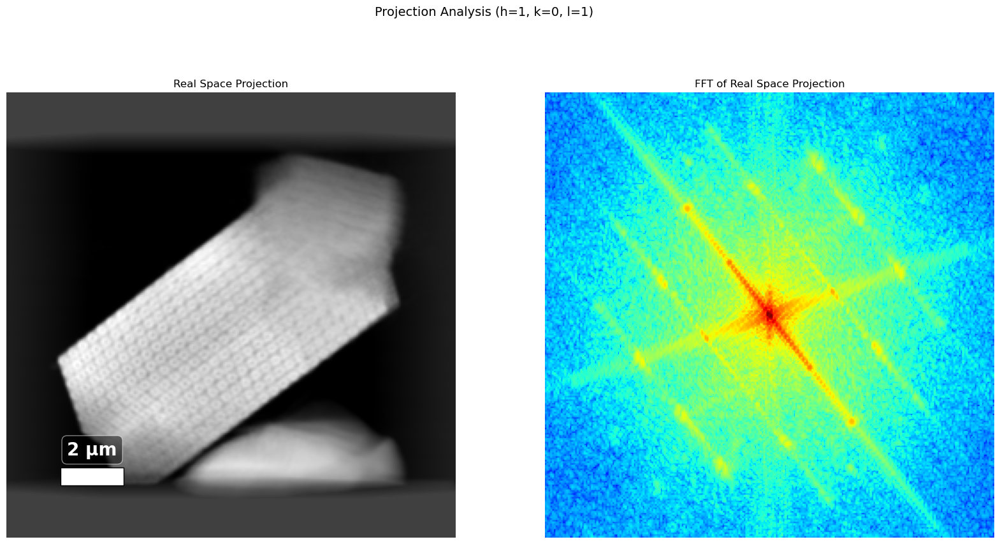

Plotting hkl projections...: 100%|██████████| 26/26 [00:33<00:00,  1.31s/it]


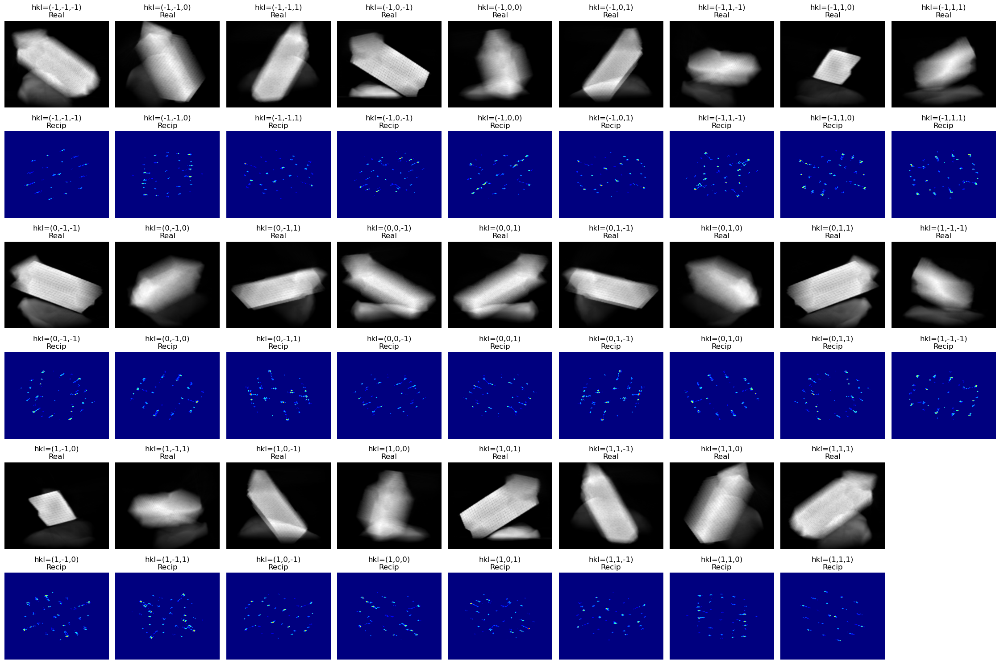


Saving outputs...
Saving 3D visualizations...
Saving projections...
Saved 5 plot files
Saving HDF5 file with all data...
Saving analysis summary...

All outputs saved to: ../example/06_Tomographic_Analysis
HDF5 file: ../example/06_Tomographic_Analysis/data/analysis_complete.h5
Summary file: ../example/06_Tomographic_Analysis/analysis_summary.txt


In [4]:
results = load_and_analyze_tomogram(
    tomogram_path=tomogram_path,
    cellinfo_path=cellinfo_path,
    pixel_size=zc9_params['pixel_size'],#14,#14,#20,#28, #56, #28,
    intensity_threshold=zc9_params['intensity_threshold'], #0.72, #0.8,
    fft_threshold=zc9_params['fft_threshold'], #0.001, #0.0001,
    output_dir='../example/06_Tomographic_Analysis/',  # Auto-creates: analysis_<name>_<timestamp>
    save_outputs=True,  # Set to False to skip saving
    center_cutoff=zc9_params['center_cutoff'], #0.01, #0.025,
    crop_tomogram=False,
    hkl_projection=zc9_params['hkl_projection'],
    crop_size=zc9_params['crop_size']
)

In [5]:
# #Access results programmatically:
# results['tomo_data']
# results['magnitude']
# results['voxel_results']
# results['cellinfo_data']
# results['figures']
# results['projections']
# results['output_dir']
# results['output_paths']
# results['figures']['tomogram'].show()
# results['figures']['fft'].show()
print('Results: ', results)
print('\n\n')
print('Results keys: ', results.keys())



Results:  {'tomo_data': array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       ...,

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,